In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
plt.style.use('seaborn')
import warnings
warnings.filterwarnings('ignore') 
import plotly.express as px
sns.set_style("darkgrid")
sns.set_context("poster")
plt.rcParams['font.size'] = 20
plt.rcParams['figure.figsize'] = 20,12

/tmp/ipykernel_1374380/3520405530.py:6: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use('seaborn')


In [2]:
data = pd.read_csv("/home/vazid.ali/Downloads/hotel_bookings.csv")

FileNotFoundError: [Errno 2] No such file or directory: '/home/vazid.ali/Downloads/hotel_bookings.csv'

In [13]:
data.head()

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [14]:
data.shape

(119390, 32)

In [15]:
pd.set_option('display.max_columns', None)

In [16]:
data.head() 

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_week_number,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,company,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date
0,Resort Hotel,0,342,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
1,Resort Hotel,0,737,2015,July,27,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,4,No Deposit,NaN,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01
2,Resort Hotel,0,7,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Direct,Direct,0,0,0,A,C,0,No Deposit,NaN,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
3,Resort Hotel,0,13,2015,July,27,1,0,1,1,0.0,0,BB,GBR,Corporate,Corporate,0,0,0,A,A,0,No Deposit,304.0,NaN,0,Transient,75.0,0,0,Check-Out,2015-07-02
4,Resort Hotel,0,14,2015,July,27,1,0,2,2,0.0,0,BB,GBR,Online TA,TA/TO,0,0,0,A,A,0,No Deposit,240.0,NaN,0,Transient,98.0,0,1,Check-Out,2015-07-03


In [17]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 32 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [22]:
def missing_percentage(data):
    temp_df = pd.DataFrame(index = data.columns[data.isnull().any()])
    temp_df['Number of missing values'] = data.isnull().sum()
    temp_df['Percentage']  = data.isnull().mean().round(4)*100
    return temp_df

In [23]:
#Show Missing Values
missing_percentage(data)

,Number of missing values,Percentage
children,4,0.00
country,488,0.41
agent,16340,13.69
company,112593,94.31


In [24]:
# Check if the data contain duplicated row or not 
data.duplicated().sum()

31994

In [25]:
#Drop Duplicated Values
data.drop_duplicates(inplace=True)
# confirming changes
data.duplicated().sum()

0

In [26]:
#data.drop('company',axis=1,inplace=True)
#data.drop('arrival_date_week_number',axis=1,inplace=True)
data=data.drop(columns=['company','arrival_date_week_number'])

In [27]:
data['arrival_date'] = data['arrival_date_month'] + " " + data['arrival_date_day_of_month'].astype(str) + " " + data['arrival_date_year'].astype(str)
data['arrival_date'] = pd.to_datetime(data['arrival_date'])
data.head(1)

,hotel,is_canceled,lead_time,arrival_date_year,arrival_date_month,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,agent,days_in_waiting_list,customer_type,adr,required_car_parking_spaces,total_of_special_requests,reservation_status,reservation_status_date,arrival_date
0,Resort Hotel,0,342,2015,July,1,0,0,2,0.0,0,BB,PRT,Direct,Direct,0,0,0,C,C,3,No Deposit,NaN,0,Transient,0.0,0,0,Check-Out,2015-07-01,2015-07-01


In [28]:
data['reservation_status_date'] = pd.to_datetime(data['reservation_status_date'])


In [29]:
fig = px.box(data, y='agent',notched=True)
fig.show()

In [30]:
fig = px.box(data, y='children')
fig.show()

In [31]:
#Fill missing values
data.fillna({
    'country' :data['country'].mode()[0],
    'children' : data['children'].median(),
    'agent': data['agent'].median()
}, inplace=True)

#Check
data.isnull().sum().sort_values(ascending=False)[:4]

hotel                      0
previous_cancellations     0
reservation_status_date    0
reservation_status         0
dtype: int64

In [32]:
data = data[data['adults'] != 0]
data = data[data['adr'] > 0.00]
# confirming changes
data.shape

(85373, 31)

In [33]:
data['total_guests'] = data['adults'] + data['children']+ data['babies']


In [34]:
# Steps to make analysis easier
cols = ['is_canceled', 'is_repeated_guest']
for i in cols:
    data[i].replace(1, 'Yes', inplace=True)
    data[i].replace(0, 'No', inplace=True)
data[cols].head()

,is_canceled,is_repeated_guest
2,No,No
3,No,No
4,No,No
6,No,No
7,No,No


In [35]:
data.duplicated().sum()

26

In [36]:
data.drop_duplicates(inplace = True)
# confirming changes
data.duplicated().sum()

0

In [37]:
non_cancelled_reservations_df = data[data['is_canceled'] == 'No']
non_cancelled_reservations_df.shape


(61587, 32)

In [38]:
non_cancelled_reservations_df['price_per_guest'] = non_cancelled_reservations_df['adr']/(non_cancelled_reservations_df['adults'] + non_cancelled_reservations_df['children'] + non_cancelled_reservations_df['babies'])

In [39]:
data.to_csv('Clean Hotel Booking', index=False)

In [40]:
#Displaying some statistical summaries of the numerical columns:
data.describe()

,lead_time,arrival_date_year,arrival_date_day_of_month,stays_in_weekend_nights,stays_in_week_nights,adults,children,babies,previous_cancellations,previous_bookings_not_canceled,booking_changes,agent,days_in_waiting_list,adr,required_car_parking_spaces,total_of_special_requests,total_guests
count,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000,85347.000000
mean,80.626290,2016.215590,15.821552,1.017282,2.653286,1.886253,0.135388,0.010756,0.029023,0.169180,0.265118,83.568784,0.743775,108.638073,0.084971,0.699286,2.032397
std,85.884725,0.684698,8.836634,1.026558,2.032749,0.493315,0.448670,0.113535,0.365303,1.677863,0.702278,108.867945,10.014634,53.386704,0.282721,0.830609,0.701287
min,0.000000,2015.000000,1.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.260000,0.000000,0.000000,1.000000
25%,12.000000,2016.000000,8.000000,0.000000,1.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,0.000000,74.570000,0.000000,0.000000,2.000000
50%,50.000000,2016.000000,16.000000,1.000000,2.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,14.000000,0.000000,99.000000,0.000000,0.000000,2.000000
75%,126.000000,2017.000000,23.000000,2.000000,4.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,240.000000,0.000000,135.000000,0.000000,1.000000,2.000000
max,709.000000,2017.000000,31.000000,19.000000,50.000000,4.000000,10.000000,10.000000,26.000000,72.000000,18.000000,535.000000,391.000000,5400.000000,8.000000,5.000000,12.000000


In [41]:
non_cancelled_reservations_df['arrival_date_year'].unique()

array([2015, 2016, 2017])

In [42]:
# The dataset has data from the year 2015 to 2017.

fig = px.bar(data, x = data.arrival_date_year.value_counts().index,
             y = data['arrival_date_year'].value_counts().to_list(), 
             labels = {'y' : 'Count', 
                       'x' : 'Arrival Date Year'}
            )
fig.show()

In [43]:
# Where Are More Cancelation?
fig =px.pie(data, 
       values = data['hotel'].value_counts(), 
       names = data['hotel'].unique(), 
       )
fig.update_layout(
    legend_title="Hotel",
    font=dict(
        size=20
    )
)
fig.layout.template = 'plotly'
fig.update_traces(textposition='inside',textfont_size=25)#, textinfo='percent+label'
fig.show()

In [44]:
# It appears that City Hotel has more reservations than Resort Hotel .

# Is Canceled Colum
fig =px.pie(data, 
       values = data['is_canceled'].value_counts(), 
       names = data['is_canceled'].unique(), 
       )
fig.update_layout(
    title = 'Is The Reservation Cancelled ?',
    legend_title="IS Canceled",
    font=dict(
        size=20
    )
)
fig.layout.template = 'plotly'
fig.update_traces(textposition='inside',textfont_size=25)#, textinfo='percent+label'
fig.show()

In [45]:
# itt seems like close to 28% of the reservations were canceled.

# IS Canceled VS. Hotel
px.histogram (data, x = "hotel", color = 'is_canceled')

In [46]:
# The higher the percentage of reservations is , the higher the percentage of cancellation .

# IS Canceled VS. Deposit Type
px.histogram(data,x='deposit_type', color='is_canceled')

In [47]:
# Most of the reservation do not require an initial deposit. It is surprising to see that all non-refundable reservations were canceled. It also looks like the hotel does not charge an initial deposit fee while the customers make their reservations.

# Lead Time Column
px.histogram (data, x = "lead_time", nbins = 500, marginal = "box")

In [48]:
# Most of the reservations are made in the system 0 to 1 day before the guests arrive in the hotel.

# Distribution Channel Column
px.histogram(data, x = "distribution_channel", color = 'is_canceled')

In [49]:
# Most of the bookings come from Travel Agents or Tour Operators. It will be intresting to see how much the customers coming from these channels pay daily.

# ADR VS. Distribution Channel
px.violin(data, x = "distribution_channel", y = "adr")

In [50]:
# Customers who make Direct booking tend to pay a higher ADR compared to the customers from other channel. The reservation with ADR of 5400 for TA/TO clearly looks like an outlier.


px.box(non_cancelled_reservations_df, x = "arrival_date_year", y = "price_per_guest", color = "hotel")

In [51]:
# City Hotel is costlier than Resort Hotel and it looks like the price per guest of City Hotel is increasing over the years.
fig =px.pie(data, 
       values = data['meal'].value_counts(), 
       names = data['meal'].unique(), 
       )
fig.update_layout(
    title = 'Distribution of Meals',
    legend_title="Meals",
    font=dict(
        size=20
    )
)
fig.layout.template = 'plotly'
fig.update_traces(textposition='inside',textfont_size=25)#, textinfo='percent+label'
fig.show()

In [52]:
# Meal VS. Price Per Guest
px.box(non_cancelled_reservations_df, x = "arrival_date_year", y = "price_per_guest", color = "meal",notched=True)


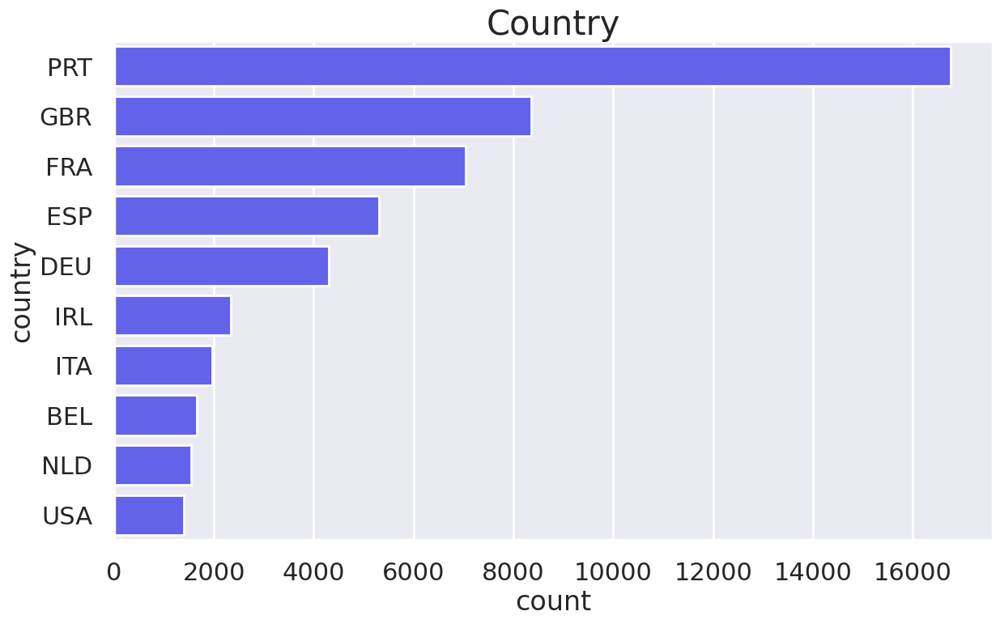

In [53]:
# Where do the guests come from?
country_counts = non_cancelled_reservations_df['country'].value_counts()
country_counts_df = pd.DataFrame({'Country' : country_counts.index, 
                                  'Count' : country_counts.values})
plt.figure(figsize=(14,8))
sns.countplot(data=non_cancelled_reservations_df, y='country', order=country_counts.index[:10], color='#4d4dff')
plt.title('Country', fontsize=30);

In [54]:
px.choropleth(
    country_counts_df, 
    locations = 'Country',
    color = 'Count',     
    labels={'Count':'Number of Guests'}, 
    title = 'Home Country of Guests'
    )

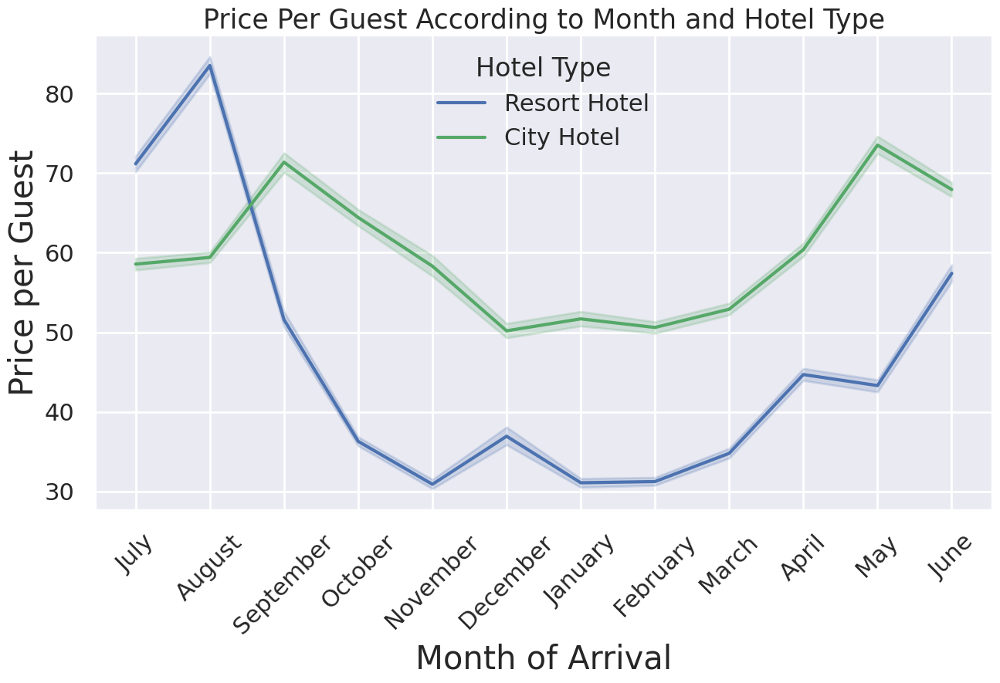

In [55]:
plt.figure(figsize = (15,8))
fig = sns.lineplot(x = 'arrival_date_month', 
             y = 'price_per_guest', 
             hue = 'hotel', 
             data = non_cancelled_reservations_df, 
            )
plt.xlabel('Month of Arrival', fontsize = 30)
plt.xticks(rotation=45)
plt.ylabel('Price per Guest', fontsize = 30)
plt.legend(title = 'Hotel Type')
plt.title('Price Per Guest According to Month and Hotel Type', fontsize = 25); 

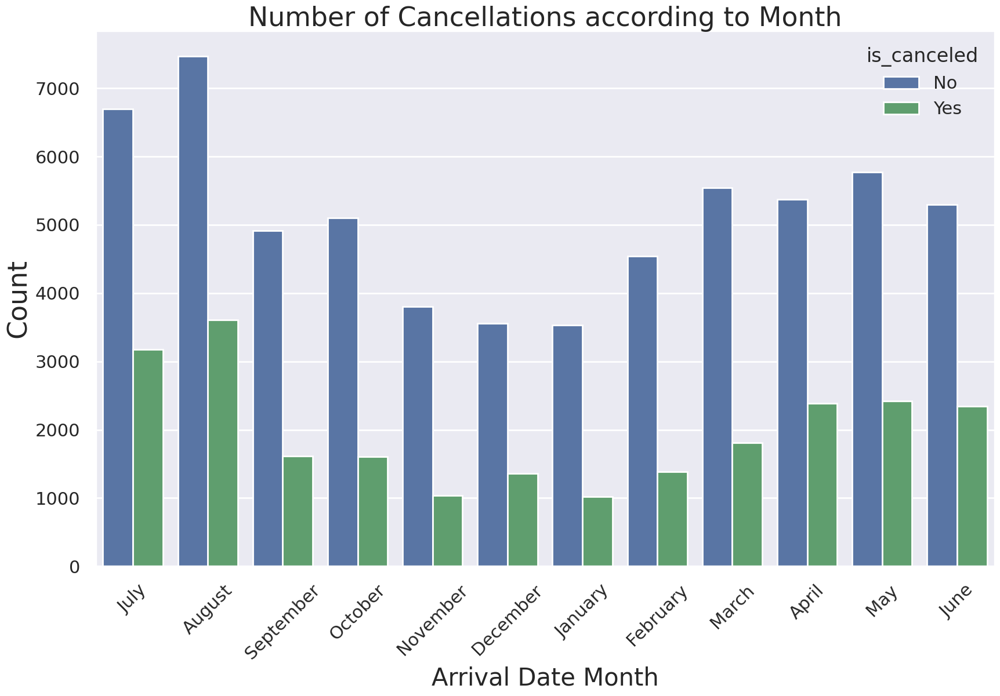

In [56]:
# The dataset has data from the year 2015 to 2017 with months of data missing for year 2015 and 2017. It seems like August has the highest number of bookings followed by July with second highest bookings if we do not take an account of the missing data. Overall, I feel May should have the most number of booking for the three years.

# It also clear that the number of bookings for City Hotel is more than the number of booking for Resort Hotel.

sns.countplot(data = data, 
              x = 'arrival_date_month', 
              hue = 'is_canceled'
              )
plt.xlabel('Arrival Date Month', fontsize = 30)
plt.xticks(rotation=45)
plt.ylabel('Count', fontsize = 33)
plt.title('Number of Cancellations according to Month', fontsize = 33);

In [58]:
# What is the customer type of the bookings?
fig =px.pie(non_cancelled_reservations_df, 
       values = non_cancelled_reservations_df['customer_type'].value_counts(), 
       names = non_cancelled_reservations_df['customer_type'].unique(), 
       )
fig.update_layout(
    title = 'Customer Segment of Bookings',
    legend_title="Customer Type",
    font=dict(
        size=20
    )
)
fig.layout.template = 'plotly'
fig.update_traces(textposition='inside',textfont_size=20)#, textinfo='percent+label'
fig.show()